## Fusion of Features UKBB

In [1]:
### import the packages and libraries

import pandas as pd
import matplotlib
#matplotlib.use('Qt5Agg')
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, classification_report, recall_score, precision_score, roc_auc_score, roc_curve
from sklearn.svm import LinearSVC, SVC
from sklearn.feature_selection import SelectKBest, f_classif, chi2, RFECV, RFE
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
import pickle
import seaborn as sns
from tabulate import tabulate

path1= r'C:\Users\alejandro\Documents\files_master\ATFB\XL'
path2 = r'C:\Users\alejandro\Documents\files_master\Larger_Dataset\ATRIAL FIBRILIATION'


### Radiomics Features

In [2]:
HCR_raw = pd.read_csv(path2+ '/atfb_tot.csv', index_col=0)
print(HCR_raw.shape)


RF_df = HCR_raw.loc[:,~ HCR_raw.columns.str.startswith('diagnostics')]
print(RF_df.shape)

(440, 680)
(440, 680)


In [3]:
RF_df.sort_values('f.eid', inplace=True)

In [4]:
y_train_df = RF_df['class']

rad_train = RF_df.iloc[:,:-1]

#ED_train_df = RF_df.filter(regex='ED')
#ES_train_df = RF_df.filter(regex='ES')

#rad_train = pd.concat([ED_train_df, ES_train_df], axis = 1)

In [5]:
rad_train.head()

,f.eid,Volume_LV_ED,SurfaceArea_LV_ED,SurfaceAreatoVolumeRatio_LV_ED,Sphericity_LV_ED,SphericalDisproportion_LV_ED,Compactness_LV_ED,Compactness2_LV_ED,Max3Ddiameter_LV_ED,Max2DdiameterSlice_LV_ED,...,DependenceNonUniformityNormalized_gldm_MYO_ES,GrayLevelVariance_gldm_MYO_ES,DependenceVariance_gldm_MYO_ES,DependenceEntropy_gldm_MYO_ES,LowGrayLevelEmphasis_gldm_MYO_ES,HighGrayLevelEmphasis_gldm_MYO_ES,SmallDependenceLowGrayLevelEmphasis_gldm_MYO_ES,SmallDependenceHighGrayLevelEmphasis_gldm_MYO_ES,LargeDependenceLowGrayLevelEmphasis_gldm_MYO_ES,LargeDependenceHighGrayLevelEmphasis_gldm_MYO_ES
8,1002513,161475.4165,18347.49029,0.114263,0.778674,Deprecated,Deprecated,Deprecated,98.448251,66.676437,...,0.049950,0.543073,30.423573,5.834765,0.127426,10.615693,0.007023,0.349350,16.727131,1835.485989
11,1003177,167950.4539,20927.86259,0.125441,0.700296,Deprecated,Deprecated,Deprecated,99.878718,78.706257,...,0.045827,0.410879,38.049748,5.683738,0.089275,13.459016,0.004913,0.506779,15.885040,2807.541878
54,1014192,116951.1752,14446.68637,0.124396,0.796815,Deprecated,Deprecated,Deprecated,89.230147,54.318326,...,0.057043,0.846209,23.930582,5.758869,0.073596,17.032978,0.005448,1.339227,8.567316,1916.499515
71,1019300,197688.8987,21231.90867,0.107944,0.770350,Deprecated,Deprecated,Deprecated,109.342864,68.210567,...,0.051892,0.619653,28.923363,5.976649,0.141879,9.961501,0.008660,0.334861,20.430174,1791.070147
84,1023154,109174.4703,14942.90187,0.138011,0.735185,Deprecated,Deprecated,Deprecated,88.573143,57.074903,...,0.056946,0.671856,23.721865,5.898869,0.189246,8.144385,0.007164,0.280300,22.695810,1106.657754


In [6]:
count = 0
drop_list = list()
for col in rad_train.dtypes:
    if col == 'object':
        drop_list.append(count)
    count +=1

print(len(drop_list))


rad_train = rad_train.drop(rad_train.columns[drop_list], axis = 1)

rad_train.shape

48


(440, 631)

In [7]:
rad_train.head()

,f.eid,Volume_LV_ED,SurfaceArea_LV_ED,SurfaceAreatoVolumeRatio_LV_ED,Sphericity_LV_ED,Max3Ddiameter_LV_ED,Max2DdiameterSlice_LV_ED,Max2DdiameterColumn_LV_ED,Max2DdiameterRow_LV_ED,MajorAxis_LV_ED,...,DependenceNonUniformityNormalized_gldm_MYO_ES,GrayLevelVariance_gldm_MYO_ES,DependenceVariance_gldm_MYO_ES,DependenceEntropy_gldm_MYO_ES,LowGrayLevelEmphasis_gldm_MYO_ES,HighGrayLevelEmphasis_gldm_MYO_ES,SmallDependenceLowGrayLevelEmphasis_gldm_MYO_ES,SmallDependenceHighGrayLevelEmphasis_gldm_MYO_ES,LargeDependenceLowGrayLevelEmphasis_gldm_MYO_ES,LargeDependenceHighGrayLevelEmphasis_gldm_MYO_ES
8,1002513,161475.4165,18347.49029,0.114263,0.778674,98.448251,66.676437,97.836102,96.461863,86.649204,...,0.049950,0.543073,30.423573,5.834765,0.127426,10.615693,0.007023,0.349350,16.727131,1835.485989
11,1003177,167950.4539,20927.86259,0.125441,0.700296,99.878718,78.706257,99.325807,99.325807,88.811055,...,0.045827,0.410879,38.049748,5.683738,0.089275,13.459016,0.004913,0.506779,15.885040,2807.541878
54,1014192,116951.1752,14446.68637,0.124396,0.796815,89.230147,54.318326,86.495074,87.206025,79.977580,...,0.057043,0.846209,23.930582,5.758869,0.073596,17.032978,0.005448,1.339227,8.567316,1916.499515
71,1019300,197688.8987,21231.90867,0.107944,0.770350,109.342864,68.210567,107.106969,107.106969,98.118618,...,0.051892,0.619653,28.923363,5.976649,0.141879,9.961501,0.008660,0.334861,20.430174,1791.070147
84,1023154,109174.4703,14942.90187,0.138011,0.735185,88.573143,57.074903,86.495075,87.206026,74.793122,...,0.056946,0.671856,23.721865,5.898869,0.189246,8.144385,0.007164,0.280300,22.695810,1106.657754


In [8]:
y_train_df.value_counts()

ATFB       220
HEALTHY    220
Name: class, dtype: int64

In [9]:
rad_train.reset_index(inplace=True)

### DLR

In [10]:
DLR_raw = pd.read_csv(path1+'/iLM_features.csv', index_col=0)

In [11]:
DLR_raw.head()

,0,ED_dlf_0,ED_dlf_1,ED_dlf_2,ED_dlf_3,ED_dlf_4,ED_dlf_5,ED_dlf_6,ED_dlf_7,ED_dlf_8,...,ES_dlf_246,ES_dlf_247,ES_dlf_248,ES_dlf_249,ES_dlf_250,ES_dlf_251,ES_dlf_252,ES_dlf_253,ES_dlf_254,ES_dlf_255
0,3230855,0.000000,0.001106,0.007028,0.006022,0.003352,0.005192,0.000000,0.003203,0.000099,...,0.0,0.010230,0.014774,0.004722,0.000000,0.000464,0.0,0.000733,0.001423,0.013717
1,2065722,0.002362,0.000000,0.012192,0.003263,0.000000,0.003035,0.000000,0.006907,0.004235,...,0.0,0.006498,0.020146,0.010125,0.000000,0.002640,0.0,0.000768,0.000000,0.015807
2,5106611,0.007388,0.004957,0.009626,0.000663,0.003548,0.005375,0.005565,0.005711,0.000295,...,0.0,0.008837,0.016787,0.013711,0.000000,0.002095,0.0,0.000000,0.000000,0.013206
3,2947009,0.009895,0.000000,0.012514,0.000690,0.006891,0.003169,0.000000,0.012944,0.002692,...,0.0,0.011124,0.017015,0.017676,0.000000,0.004092,0.0,0.000000,0.000000,0.017930
4,3738863,0.009987,0.000000,0.007593,0.001529,0.009839,0.008639,0.000261,0.011606,0.008897,...,0.0,0.017721,0.013430,0.000000,0.006928,0.000000,0.0,0.000000,0.000000,0.011440


In [12]:
DLR_raw.sort_values('0', inplace=True)

In [13]:
DLR_raw.reset_index(inplace=True)

### Concatenation

In [14]:
tot_set = pd.concat([rad_train, DLR_raw], axis=1)

In [15]:
count = 0
drop_list = list()
for col in tot_set.dtypes:
    if col == 'object':
        drop_list.append(count)
    count +=1

print(len(drop_list))

0


In [16]:
ids = tot_set['f.eid']

In [17]:
tot_set.drop(['index', 'f.eid', '0'], axis=1, inplace=True)

In [18]:
tot_set.head()

,Volume_LV_ED,SurfaceArea_LV_ED,SurfaceAreatoVolumeRatio_LV_ED,Sphericity_LV_ED,Max3Ddiameter_LV_ED,Max2DdiameterSlice_LV_ED,Max2DdiameterColumn_LV_ED,Max2DdiameterRow_LV_ED,MajorAxis_LV_ED,MinorAxis_LV_ED,...,ES_dlf_246,ES_dlf_247,ES_dlf_248,ES_dlf_249,ES_dlf_250,ES_dlf_251,ES_dlf_252,ES_dlf_253,ES_dlf_254,ES_dlf_255
0,161475.4165,18347.49029,0.114263,0.778674,98.448251,66.676437,97.836102,96.461863,86.649204,54.834520,...,0.0,0.008635,0.021976,0.011256,0.0,0.003652,0.0,0.000000,0.0,0.013127
1,167950.4539,20927.86259,0.125441,0.700296,99.878718,78.706257,99.325807,99.325807,88.811055,60.156201,...,0.0,0.007442,0.020148,0.019733,0.0,0.000653,0.0,0.003761,0.0,0.027924
2,116951.1752,14446.68637,0.124396,0.796815,89.230147,54.318326,86.495074,87.206025,79.977580,46.454301,...,0.0,0.023517,0.017174,0.007126,0.0,0.000000,0.0,0.000000,0.0,0.021764
3,197688.8987,21231.90867,0.107944,0.770350,109.342864,68.210567,107.106969,107.106969,98.118618,56.378777,...,0.0,0.005886,0.019665,0.020304,0.0,0.003477,0.0,0.001784,0.0,0.022297
4,109174.4703,14942.90187,0.138011,0.735185,88.573143,57.074903,86.495075,87.206026,74.793122,48.066735,...,0.0,0.010185,0.014965,0.015487,0.0,0.003310,0.0,0.000000,0.0,0.015504


### Y_class

In [19]:
class_list= list(y_train_df.unique())

### ML Grid Search

In [20]:
def KBest_GS(X_train, y_train, X_test, y_test, model, param_grid, x_df):
    
    selector = SelectKBest()
    
    ### Pipeline
    
    ### we would need to adapt the "NUMBER OF FEATURES PARAMETER OF THE GRID"
    
    pipe = Pipeline([('selector', selector), 
                 ('model', model)])

    featss = np.array(range(5, X_train.shape[1]))
    
    #featss = np.array(range(5,8))

    dict_1 = {'selector__score_func': [f_classif, chi2],
              'selector__k':featss}   #### para pruebas
    
    dict_1.update(param_grid)
    
    gs = GridSearchCV(estimator=pipe, 
                  param_grid=dict_1, 
                  scoring=['accuracy', 'roc_auc', 'f1', 'precision', 'recall'], 
                  n_jobs=1, 
                  cv=StratifiedKFold(3, shuffle=True, random_state=42),
                  refit='accuracy',
                verbose=1)
    
    print(pipe.get_params().keys())
    
    gs = gs.fit(X_train, y_train)
    
    print("Best Model", gs.best_params_)
    
    print('Best score:', gs.best_score_)
    
    y_test_pred = gs.predict(X_test)
    
    test_acc = accuracy_score(y_test,y_test_pred)
    probs=gs.predict_proba(X_test_p)
    probs = probs[:, 1]
    ROC_AUC = roc_auc_score(y_test, probs)
    precison_scor = precision_score(y_test,y_test_pred)
    recall_scor = recall_score(y_test, y_test_pred)
    
    fpr, tpr, thresholds = roc_curve(y_testp, probs)
    
    print("\n Test Accuracy with best estimator: ", test_acc)
    print("\n Roc AUC with best estimator: ", ROC_AUC)
    print("\n Precision with best estimator: ", precison_scor)
    print("\n Recall with best estimator: ", recall_scor, "\n")
    
    
    l = [[test_acc, ROC_AUC, precison_scor, recall_scor]]
    table = tabulate(l, headers=['Accuracy', 'ROC_AUC', 'Precision', 'Recall'], tablefmt='orgtbl')
    
    print(table)
    
    cm = confusion_matrix(y_test, y_test_pred)
        
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    
    fig = plt.figure(figsize=(10,4))
    fig.add_subplot(121)
#     plt.imshow(cm_normalized, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion Matrix")
    sns.heatmap(cm, annot=True, cmap=plt.cm.Blues, fmt='g')
    plt.tight_layout()

    tick_marks = np.arange(len(class_list))
    plt.xticks(tick_marks+0.5, class_list, rotation=45)
    plt.yticks(tick_marks+0.5, class_list)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
    fig.add_subplot(122)
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.tight_layout()

    plt.show()

    print(classification_report(y_test, y_test_pred,target_names=class_list))
    
    cols = gs.best_estimator_.steps[0][1].get_support(indices=True)
    features_df_new = x_df.iloc[:,cols]
    K_best = list(features_df_new.columns)
    
    print(K_best)
    
    return gs, K_best

In [21]:
def plot_roc_curve(fpr, tpr):
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()

In [22]:
#Support Vector Classifier

model_SVC = SVC(gamma = 'scale', probability=True, max_iter= 5000, random_state=42)

param_grid_SVC =  {'model__kernel':('linear', 'rbf'), 
                   'model__C':[0.3, 0.5, 1,5, 10]}

In [23]:
scaler = MinMaxScaler()
X_sc = scaler.fit_transform(tot_set)

encoder = LabelEncoder()
y_enc = encoder.fit_transform(y_train_df)

In [24]:
X_train_p, X_test_p, y_trainp, y_testp = train_test_split(X_sc, y_enc, test_size=80,
                                                   shuffle=True,
                                                    stratify=y_train_df,
                                                   random_state=42)

dict_keys(['memory', 'steps', 'verbose', 'selector', 'model', 'selector__k', 'selector__score_func', 'model__C', 'model__break_ties', 'model__cache_size', 'model__class_weight', 'model__coef0', 'model__decision_function_shape', 'model__degree', 'model__gamma', 'model__kernel', 'model__max_iter', 'model__probability', 'model__random_state', 'model__shrinking', 'model__tol', 'model__verbose'])
Fitting 3 folds for each of 22740 candidates, totalling 68220 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.wa

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver termin

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / ms

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\si

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / ms

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\si

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\si

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\si

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\si

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  73

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in t

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / ms

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  war

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with 

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-p

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  67

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\svm\_base.py:246: ConvergenceWarning: Solver terminated early (max_iter=5000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn('Solver terminated early (max_iter=%i).'
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  65

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  658  673  690  714  735  737  742  758  764  794
  803  814  817  829  832  853  874  882  902  908  909  946  970  991
  998 1006 1014 1020 1050 1059 1072 1074 1082 1088 1109 1130] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,


C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  653  673  690  714  716  728  731  735  737  742
  758  764  794  803  817  829  832  846  859  902  908  909  946  970
  991  998 1006 1014 1020 1050 1059 1063 1064 1082 1088 1138] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:116: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw
C:\Users\alejandro\anaconda3\lib\site-packages\sklearn\feature_selection\_univariate_selection.py:114: UserWarning: Features [ 646  648  650  652  673  690  714  719  735  737  742  758  764  773
  790  794  803  817  829  832  838  902  908  909  946  970  991  998
 1006 1014 1020 1050 1059 1082 1088] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx,
C:\Users\alejandro\anacon

Best Model {'model__C': 10, 'model__kernel': 'linear', 'selector__k': 271, 'selector__score_func': <function f_classif at 0x000001C0C50A3EE0>}
Best score: 0.7222222222222223

 Test Accuracy with best estimator:  0.6

 Roc AUC with best estimator:  0.619375

 Precision with best estimator:  0.5869565217391305

 Recall with best estimator:  0.675 

|   Accuracy |   ROC_AUC |   Precision |   Recall |
|------------+-----------+-------------+----------|
|        0.6 |  0.619375 |    0.586957 |    0.675 |


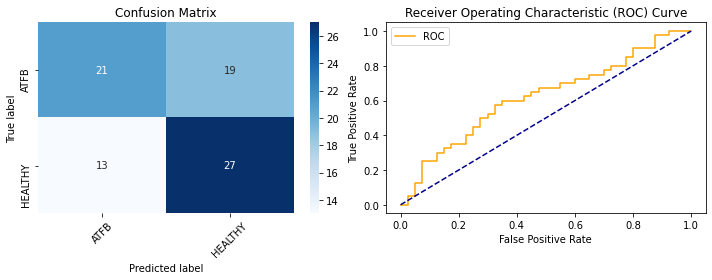

              precision    recall  f1-score   support

        ATFB       0.62      0.53      0.57        40
     HEALTHY       0.59      0.68      0.63        40

    accuracy                           0.60        80
   macro avg       0.60      0.60      0.60        80
weighted avg       0.60      0.60      0.60        80

['Volume_LV_ED', 'SurfaceArea_LV_ED', 'Max2DdiameterSlice_LV_ED', 'MinorAxis_LV_ED', 'LeastAxis_LV_ED', 'Elongation_LV_ED', 'Flatness_LV_ED', 'Volume_LV_ES', 'SurfaceArea_LV_ES', 'Max3Ddiameter_LV_ES', 'Max2DdiameterSlice_LV_ES', 'Max2DdiameterColumn_LV_ES', 'MinorAxis_LV_ES', 'LeastAxis_LV_ES', 'Volume_RV_ED', 'SurfaceArea_RV_ED', 'LeastAxis_RV_ED', 'Volume_RV_ES', 'SurfaceArea_RV_ES', 'MajorAxis_RV_ES', 'LeastAxis_RV_ES', 'Volume_MYO_ED', 'SurfaceArea_MYO_ED', 'SurfaceAreatoVolumeRatio_MYO_ED', 'Sphericity_MYO_ED', 'Max2DdiameterSlice_MYO_ED', 'MinorAxis_MYO_ED', 'LeastAxis_MYO_ED', 'Volume_MYO_ES', 'SurfaceArea_MYO_ES', 'Max3Ddiameter_MYO_ES', 'Max2DdiameterSlic

In [25]:
gs, K_best = KBest_GS(X_train_p, y_trainp, X_test_p, y_testp, model_SVC, param_grid_SVC, tot_set)